In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [3]:
links = pd.read_csv('../../Some Data/ml-latest-small/links.csv')
ratings = pd.read_csv('..\..\Some Data\ml-latest-small/ratings.csv')
movies = pd.read_csv('..\..\Some Data\ml-latest-small/movies.csv')
tags = pd.read_csv('..\..\Some Data\ml-latest-small/tags.csv')

In [4]:
links

,movieId,imdbId,tmdbId
0,1,114709,862.0
1,2,113497,8844.0
2,3,113228,15602.0
3,4,114885,31357.0
4,5,113041,11862.0
...,...,...,...
9737,193581,5476944,432131.0
9738,193583,5914996,445030.0
9739,193585,6397426,479308.0
9740,193587,8391976,483455.0


In [5]:
ratings

,userId,movieId,rating,timestamp
0,1,1,4.0,964982703
1,1,3,4.0,964981247
2,1,6,4.0,964982224
3,1,47,5.0,964983815
4,1,50,5.0,964982931
...,...,...,...,...
100831,610,166534,4.0,1493848402
100832,610,168248,5.0,1493850091
100833,610,168250,5.0,1494273047
100834,610,168252,5.0,1493846352


In [6]:
ratings_per_movie = ratings.groupby(by='movieId')['rating'].count()
ratings_per_movie.loc[ratings_per_movie < 20].count()/ratings_per_movie.count()

0.8666186754422048

In [7]:
print(movies.title.nunique())
movies


9737


,movieId,title,genres
0,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy
1,2,Jumanji (1995),Adventure|Children|Fantasy
2,3,Grumpier Old Men (1995),Comedy|Romance
3,4,Waiting to Exhale (1995),Comedy|Drama|Romance
4,5,Father of the Bride Part II (1995),Comedy
...,...,...,...
9737,193581,Black Butler: Book of the Atlantic (2017),Action|Animation|Comedy|Fantasy
9738,193583,No Game No Life: Zero (2017),Animation|Comedy|Fantasy
9739,193585,Flint (2017),Drama
9740,193587,Bungo Stray Dogs: Dead Apple (2018),Action|Animation


In [8]:
movies_genres = movies.genres.str.get_dummies(sep='|')
movies_genres.rename({'(no genres listed)': 'Unlisted'}, axis=1, inplace=True)
movies_genres.rename(lambda x: x.lower(), axis=1, inplace=True)
movies_genres

,unlisted,action,adventure,animation,children,comedy,crime,documentary,drama,fantasy,film-noir,horror,imax,musical,mystery,romance,sci-fi,thriller,war,western
0,0,0,1,1,1,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0
1,0,0,1,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0
3,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,1,0,0,0,0
4,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9737,0,1,0,1,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0
9738,0,0,0,1,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0
9739,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
9740,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [9]:
movies = pd.concat([movies, movies_genres], axis=1)
movies

,movieId,title,genres,unlisted,action,adventure,animation,children,comedy,crime,...,film-noir,horror,imax,musical,mystery,romance,sci-fi,thriller,war,western
0,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,0,0,1,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0
1,2,Jumanji (1995),Adventure|Children|Fantasy,0,0,1,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
2,3,Grumpier Old Men (1995),Comedy|Romance,0,0,0,0,0,1,0,...,0,0,0,0,0,1,0,0,0,0
3,4,Waiting to Exhale (1995),Comedy|Drama|Romance,0,0,0,0,0,1,0,...,0,0,0,0,0,1,0,0,0,0
4,5,Father of the Bride Part II (1995),Comedy,0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9737,193581,Black Butler: Book of the Atlantic (2017),Action|Animation|Comedy|Fantasy,0,1,0,1,0,1,0,...,0,0,0,0,0,0,0,0,0,0
9738,193583,No Game No Life: Zero (2017),Animation|Comedy|Fantasy,0,0,0,1,0,1,0,...,0,0,0,0,0,0,0,0,0,0
9739,193585,Flint (2017),Drama,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
9740,193587,Bungo Stray Dogs: Dead Apple (2018),Action|Animation,0,1,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [10]:
print(tags.tag.nunique())
tags

1589


,userId,movieId,tag,timestamp
0,2,60756,funny,1445714994
1,2,60756,Highly quotable,1445714996
2,2,60756,will ferrell,1445714992
3,2,89774,Boxing story,1445715207
4,2,89774,MMA,1445715200
...,...,...,...,...
3678,606,7382,for katie,1171234019
3679,606,7936,austere,1173392334
3680,610,3265,gun fu,1493843984
3681,610,3265,heroic bloodshed,1493843978


In [11]:
ratings.userId.value_counts().sort_values()

442      20
320      20
207      20
576      20
194      20
       ... 
274    1346
448    1864
474    2108
599    2478
414    2698
Name: userId, Length: 610, dtype: int64

In [12]:
rating_grouped = ratings.groupby(by='movieId')
avg_ratings = rating_grouped['rating'].mean()
user_counts = rating_grouped['userId'].count()
latest_rating = rating_grouped['timestamp'].max()

grouped_ratings = pd.concat([avg_ratings, user_counts, latest_rating], axis=1)
grouped_ratings

,rating,userId,timestamp
movieId,,,
1,3.920930,215,1535709666
2,3.431818,110,1529901723
3,3.259615,52,1498505071
4,2.357143,7,1237760055
5,3.071429,49,1517441319
...,...,...,...
193581,4.000000,1,1537109082
193583,3.500000,1,1537109545
193585,3.500000,1,1537109805


In [13]:
movie_ratings = movies.merge(grouped_ratings, on='movieId')
movie_ratings.drop(['genres'], axis=1, inplace=True)
movie_ratings

,movieId,title,unlisted,action,adventure,animation,children,comedy,crime,documentary,...,musical,mystery,romance,sci-fi,thriller,war,western,rating,userId,timestamp
0,1,Toy Story (1995),0,0,1,1,1,1,0,0,...,0,0,0,0,0,0,0,3.920930,215,1535709666
1,2,Jumanji (1995),0,0,1,0,1,0,0,0,...,0,0,0,0,0,0,0,3.431818,110,1529901723
2,3,Grumpier Old Men (1995),0,0,0,0,0,1,0,0,...,0,0,1,0,0,0,0,3.259615,52,1498505071
3,4,Waiting to Exhale (1995),0,0,0,0,0,1,0,0,...,0,0,1,0,0,0,0,2.357143,7,1237760055
4,5,Father of the Bride Part II (1995),0,0,0,0,0,1,0,0,...,0,0,0,0,0,0,0,3.071429,49,1517441319
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9719,193581,Black Butler: Book of the Atlantic (2017),0,1,0,1,0,1,0,0,...,0,0,0,0,0,0,0,4.000000,1,1537109082
9720,193583,No Game No Life: Zero (2017),0,0,0,1,0,1,0,0,...,0,0,0,0,0,0,0,3.500000,1,1537109545
9721,193585,Flint (2017),0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,3.500000,1,1537109805
9722,193587,Bungo Stray Dogs: Dead Apple (2018),0,1,0,1,0,0,0,0,...,0,0,0,0,0,0,0,3.500000,1,1537110021


In [14]:
movie_ratings['releaseYear'] = movie_ratings.title.str.extract(r'\(([0-9][0-9][0-9][0-9])\)')
movie_ratings.head()

,movieId,title,unlisted,action,adventure,animation,children,comedy,crime,documentary,...,mystery,romance,sci-fi,thriller,war,western,rating,userId,timestamp,releaseYear
0,1,Toy Story (1995),0,0,1,1,1,1,0,0,...,0,0,0,0,0,0,3.920930,215,1535709666,1995
1,2,Jumanji (1995),0,0,1,0,1,0,0,0,...,0,0,0,0,0,0,3.431818,110,1529901723,1995
2,3,Grumpier Old Men (1995),0,0,0,0,0,1,0,0,...,0,1,0,0,0,0,3.259615,52,1498505071,1995
3,4,Waiting to Exhale (1995),0,0,0,0,0,1,0,0,...,0,1,0,0,0,0,2.357143,7,1237760055,1995
4,5,Father of the Bride Part II (1995),0,0,0,0,0,1,0,0,...,0,0,0,0,0,0,3.071429,49,1517441319,1995


In [15]:
movie_ratings.dropna(axis=0, inplace=True)
movie_ratings.isna().sum().sum()

0

In [16]:
X = movie_ratings.drop(['movieId', 'title', 'timestamp'], axis=1)
X.head()

,unlisted,action,adventure,animation,children,comedy,crime,documentary,drama,fantasy,...,musical,mystery,romance,sci-fi,thriller,war,western,rating,userId,releaseYear
0,0,0,1,1,1,1,0,0,0,1,...,0,0,0,0,0,0,0,3.920930,215,1995
1,0,0,1,0,1,0,0,0,0,1,...,0,0,0,0,0,0,0,3.431818,110,1995
2,0,0,0,0,0,1,0,0,0,0,...,0,0,1,0,0,0,0,3.259615,52,1995
3,0,0,0,0,0,1,0,0,1,0,...,0,0,1,0,0,0,0,2.357143,7,1995
4,0,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,3.071429,49,1995


In [17]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
X_std = scaler.fit_transform(X)

In [18]:
import umap

umap_model = umap.UMAP(n_neighbors = 25, min_dist=.2, metric='euclidean')
umap_results = umap_model.fit_transform(X_std)

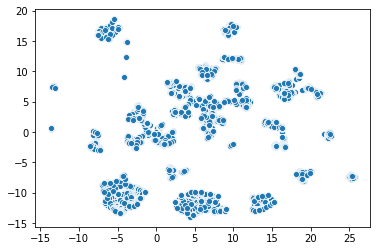

In [19]:
sns.scatterplot(x=umap_results[:,0], y=umap_results[:,1])

In [20]:
from sklearn.cluster import KMeans

str_class = 'abcdefghijklmnopqrstuvwxyz1234567890'

k_means = KMeans(n_clusters=3)

preds = k_means.fit_predict(X_std)

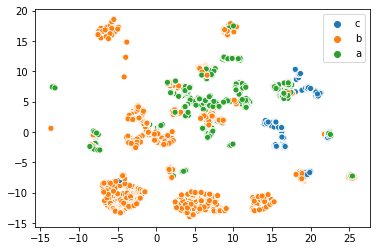

In [21]:
sns.scatterplot(x=umap_results[:,0], y=umap_results[:,1], hue=pd.Series(preds).map({i: str_class[i] for i in pd.Series(preds).unique()}))

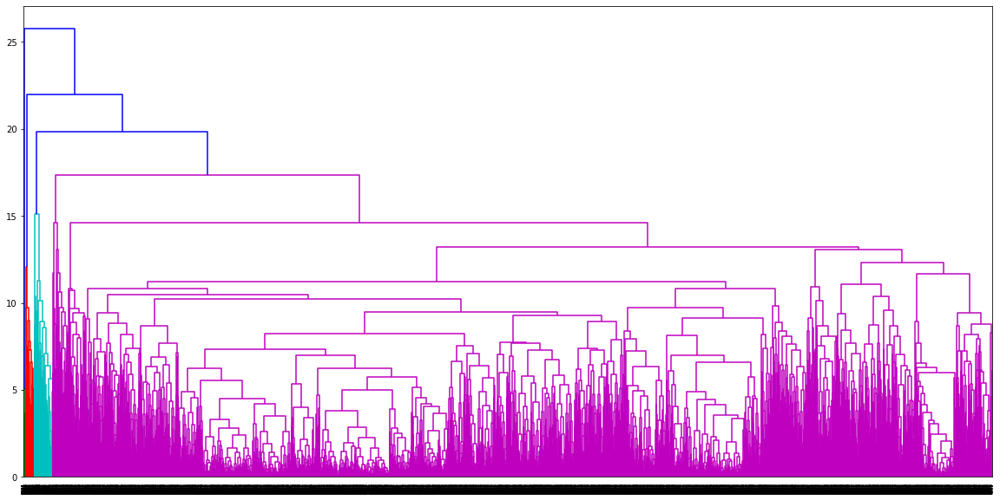

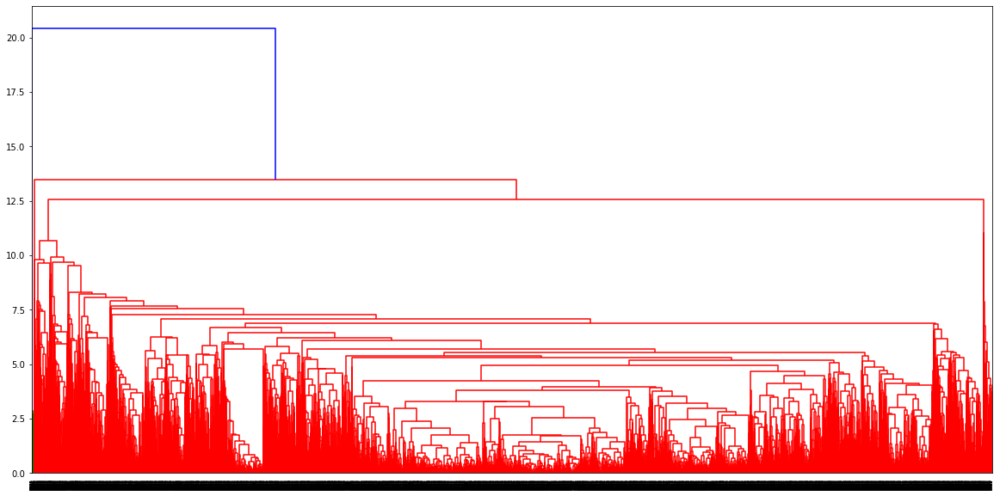

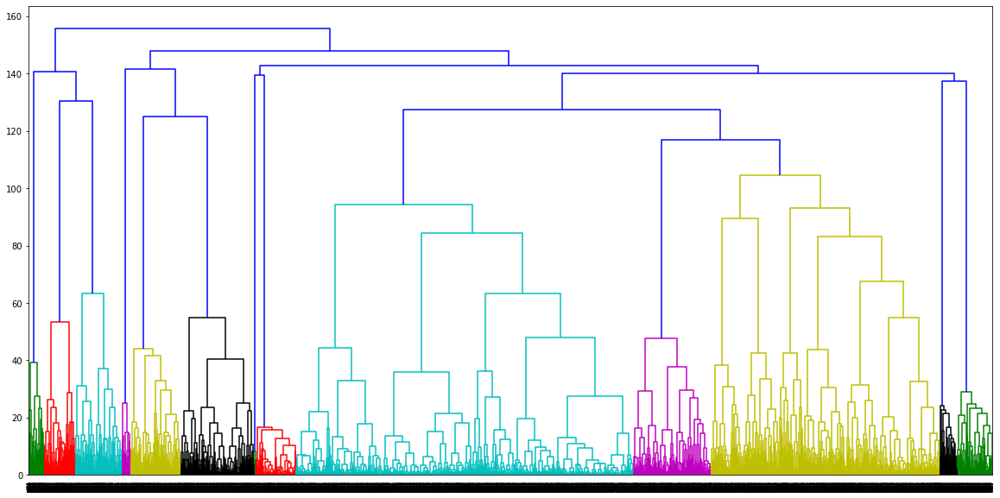

In [22]:
from scipy.cluster.hierarchy import dendrogram, linkage
methods = ['complete', 'average', 'ward']

for method in methods:
    plt.figure(figsize=(20,10))
    dendrogram(linkage(X_std, method=method))
    plt.show()

In [23]:
from sklearn.cluster import DBSCAN

eps = [.2, .5, .7, 1]
samps = [1, 2, 3, 4, 11]
metrics = ['euclidean', 'correlation', 'cosine']

for e in eps:
    for s in samps:
        for m in metrics:

            dbscan = DBSCAN(eps=e, min_samples=s, metric=m)
            preds = dbscan.fit_predict(X_std)

            preds_s = pd.Series(preds)
            num_clusts = preds_s.loc[preds_s != -1].nunique()
            print('epsilon:', e)
            print('minPts:', s)
            print('metric:', m)
            print('Number of clusters:', num_clusts)
            print('-------------------------------------------------')

epsilon: 0.2
minPts: 1
metric: euclidean
Number of clusters: 6059
-------------------------------------------------
epsilon: 0.2
minPts: 1
metric: correlation
Number of clusters: 33
-------------------------------------------------
epsilon: 0.2
minPts: 1
metric: cosine
Number of clusters: 34
-------------------------------------------------
epsilon: 0.2
minPts: 2
metric: euclidean
Number of clusters: 730
-------------------------------------------------
epsilon: 0.2
minPts: 2
metric: correlation
Number of clusters: 15
-------------------------------------------------
epsilon: 0.2
minPts: 2
metric: cosine
Number of clusters: 14
-------------------------------------------------
epsilon: 0.2
minPts: 3
metric: euclidean
Number of clusters: 281
-------------------------------------------------
epsilon: 0.2
minPts: 3
metric: correlation
Number of clusters: 10
-------------------------------------------------
epsilon: 0.2
minPts: 3
metric: cosine
Number of clusters: 10
-----------------------

In [24]:
dbscan = DBSCAN(eps=1, min_samples=20, metric='euclidean')
preds= dbscan.fit_predict(X_std)

preds_s = pd.Series(preds)

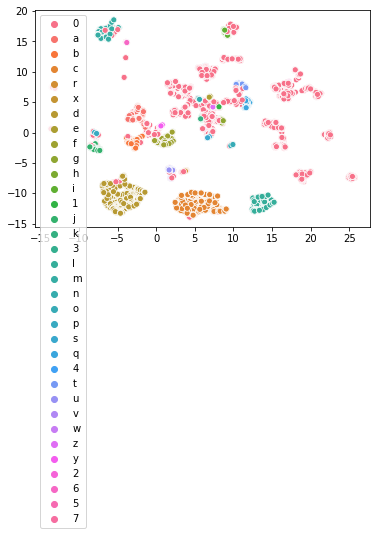

In [25]:
sns.scatterplot(x=umap_results[:,0], y=umap_results[:,1], hue=preds_s.map({i: str_class[i] for i in preds_s}))